In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from ds_contrib.core.paths import list_paths

In [3]:
from pathlib import Path

DATA_ROOT = Path("../data")
IMAGES_ROOT = DATA_ROOT / "images"
ANNOTATIONS_ROOT = DATA_ROOT / "annotations"

In [4]:
import json

In [5]:
with open(ANNOTATIONS_ROOT / "annotation_2.json") as f:
    data = json.load(f)

In [6]:
data

{'info': {},
 'categories': {'label': {'labels': [{'name': 'Reflection',
     'parent': '',
     'attributes': []},
    {'name': 'reflection_poly', 'parent': '', 'attributes': []}],
   'attributes': ['Severity', 'occluded']},
  'points': {'items': []}},
 'items': [{'id': '205',
   'annotations': [{'id': 0,
     'type': 'polygon',
     'attributes': {'occluded': False},
     'group': 0,
     'label_id': 1,
     'points': [0.0,
      932.76,
      40.96,
      930.71,
      57.01,
      925.36,
      71.99,
      901.82,
      80.54,
      876.15,
      90.17,
      830.14,
      99.8,
      802.32,
      107.29,
      779.85,
      116.92,
      772.36,
      154.37,
      772.36,
      367.29,
      765.94,
      564.15,
      755.24,
      738.9,
      744.5,
      851.97,
      734.92,
      865.88,
      727.43,
      872.29,
      717.8,
      875.5,
      707.1,
      873.36,
      696.4,
      812.38,
      654.67,
      743.9,
      617.22,
      716.08,
      606.52,
      573.

In [7]:
from rda.core.data.datumaro.dto import DatumaroAnnotationLoader
from rda.core.data.representations import BinaryMaskRepr

In [8]:
images_paths = list_paths(IMAGES_ROOT, sort=True, pattern=r".*\.png$")

In [9]:
loader = DatumaroAnnotationLoader()
loader_iter = loader.load(ANNOTATIONS_ROOT / "annotation_2.json")

In [10]:
masks = [
    dto.convert(BinaryMaskRepr, size=(1080, 1920)).data for dto in loader_iter
]


In [11]:
mask = masks[0]

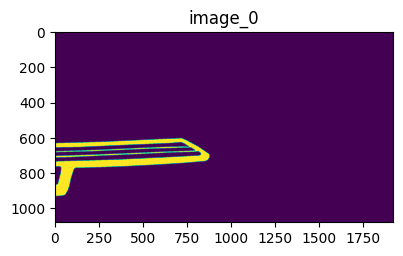

In [12]:
from ds_contrib.core.plotting import plot

plot([mask])

In [13]:
import PIL.Image

from ds_contrib.core.plotting import Color, bin_mask_overlay

frames = {}
for p in images_paths:
    image_name = p.stem
    mask_name = f"{image_name}_mask"
    frames[image_name] = PIL.Image.open(p)
    frames[mask_name] = bin_mask_overlay(
        frames[image_name], mask, mask_color=Color.GREEN, transparency=0.6
    )

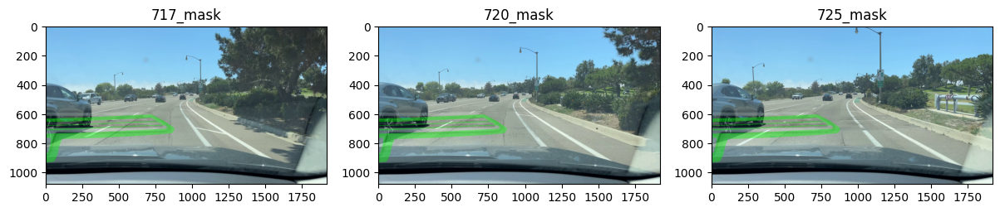

In [14]:
num_frames = 3
plot({
    k: v
    for i, (k, v) in enumerate(frames.items())
    if k.endswith("mask") and i < num_frames * 2
})


In [15]:
import cv2
import numpy as np


def draw_contours(mask, img, color: tuple[int, int, int] | int = 1):
    # Find the contours in the mask
    contours, hierarchy = cv2.findContours(
        mask.astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE
    )

    # Create a copy of the original image to draw on
    img_with_contours = np.array(img).copy()

    # Draw the contours on the image
    cv2.drawContours(img_with_contours, contours, -1, color=color, thickness=2)
    return img_with_contours

In [16]:
image = np.array(frames["717"])

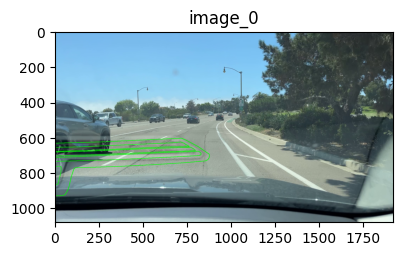

In [17]:
plot(
    draw_contours(
        mask,
        image,
        color=(0, 255, 0),
    )
)

In [88]:
contours_mask = draw_contours(mask, np.zeros((1080, 1920)))

In [20]:
def generate_soft_mask_around_contours(
    contours_mask: np.ndarray, dist_threshold: int, min_val: float, max_val: float
) -> np.ndarray:
    """Generates a soft mask around contours withing a distance threshold

    Parameters
    ----------
    contours_mask : np.ndarray
        binary mask with contours of interest
    dist_threshold : int
        distance threshold in pixels, within which the mask will be soft gradually decreasing from max_val to min_val
    min_val : float
        minimum value of the mask
    max_val : float
        maximum value of the mask

    Returns
    -------
    np.ndarray
        soft mask around contours
    """
    reversed_contour_mask = np.logical_not(contours_mask.astype(bool))
    # dist_transform to get distance from contours
    dist_transform = cv2.distanceTransform(
        reversed_contour_mask.astype(np.uint8), cv2.DIST_L2, 3
    )
    # reversed dist_transform to assign max values to contours
    reversed_dist_transform = np.abs(dist_transform - dist_transform.max())
    roi_mask = dist_transform < dist_threshold
    # mask dist transform with dist_threshold
    roi_reversed_dist_transform = np.where(roi_mask, reversed_dist_transform, 0)
    # get non zero values
    non_zero_values = roi_reversed_dist_transform[roi_reversed_dist_transform > 0]
    # normalize masked by roi values of reversed dist transform
    min_value = np.min(non_zero_values)
    max_value = np.max(non_zero_values)
    # scale from 0 to 1
    reversed_dist_transform = (reversed_dist_transform - min_value) / (
        max_value - min_value
    )
    # scale from min_val to max_val
    reversed_dist_transform = reversed_dist_transform * (max_val - min_val) + min_val
    final_dist_mask = np.where(roi_mask, reversed_dist_transform, 0)
    return final_dist_mask

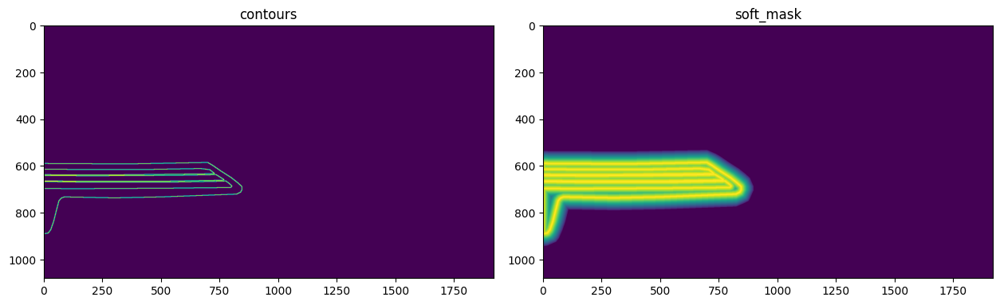

In [21]:
plot(
    {
        "contours": contours_mask,
        "soft_mask": generate_soft_mask_around_contours(
            contours_mask, 50, 20, max_val=255
        ),
    },
    max_col_width=0.5,
    max_row_height=0.5,
)

In [35]:
from ds_contrib.core.plotting import (
    Colorifiable,
    ImageLike,
    adjust_image,
    numpify_image,
)


def soft_mask_overlay(
    image: ImageLike,
    mask: np.ndarray,
    mask_color: Colorifiable | None = None,
    transparency: float = 0.5,
    dim: float = 0.0,
) -> np.ndarray:
    """Overlay a binary mask on an image with defined color and transparency.

    Parameters
    ----------
    image : np.ndarray

    mask : np.ndarray
        binary mask
    transparency : float, optional
        transparency of the mask, by default 0.5
    mask_color : Colorifiable | None, optional
        mask color, by default None
    dim : float, optional
        dim the background image, by default 0.0

    Returns
    -------
    np.ndarray
        image with overlayed mask
    """
    image = numpify_image(image)

    assert mask.ndim == 2, "Alpha mask must be 2D single channel"
    if np.issubdtype(mask.dtype, np.uint8):
        mask = mask.astype(np.float32) / 255
    elif np.issubdtype(mask.dtype, np.float32):
        if mask.max() > 1 or mask.min() < 0:
            raise ValueError("mask values must be in [0, 1]")
    else:
        raise ValueError("mask must be either uint8 or float32")

    alpha_mask = np.expand_dims(mask.astype(np.float32), axis=-1)
    inv_alpha_mask = 1 - alpha_mask

    if mask_color is None:
        mask_color = Color.WHITE

    if mask_color is not None:
        # Color handling
        mask_color = Color.from_input(mask_color)

        masked = np.full_like(image, mask_color)
        masked = (image.astype(np.float32) * inv_alpha_mask +
                  masked.astype(np.float32) * alpha_mask)
        masked = masked.astype(np.uint8)

    if dim > 0.0:
        hard_mask = alpha_mask > 0
        inv_hard_mask = 1 - hard_mask
        masked = np.where(hard_mask, masked, 0) + adjust_image(
            np.where(inv_hard_mask, masked, 0), v=(1 - dim))

    result = masked
    return result

In [48]:
soft_mask = generate_soft_mask_around_contours(contours_mask,
                                               15,
                                               0.05,
                                               max_val=0.5)


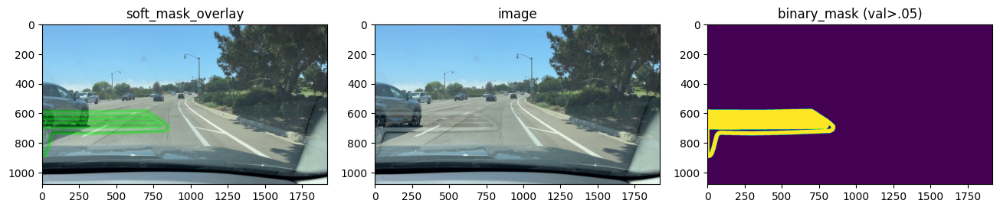

In [49]:
plot(
    {
        "soft_mask_overlay": soft_mask_overlay(
            image, soft_mask, mask_color=Color.GREEN
        ),
        "image": image,
        "binary_mask (val>.05)": soft_mask > 0.1,
    },
    max_col_width=0.33,
    max_row_height=1,
)

In [87]:
frames = {}
for p in images_paths:
    image_name = p.stem
    mask_name = f"{image_name}_mask"
    frames[image_name] = PIL.Image.open(p)
    frames[mask_name] = soft_mask_overlay(
        frames[image_name], soft_mask, mask_color=Color.GREEN
    )

ValueError: could not broadcast input array from shape (3,) into shape (1080,1920,4)

#### Reflection mask propogated through frames sequence of video


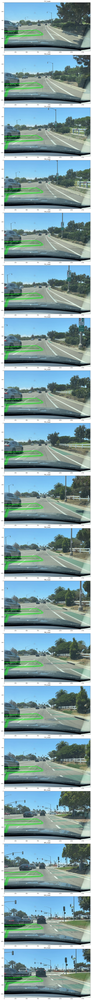

In [45]:
num_frames = 100
plot(
    {
        k: v
        for i, (k, v) in enumerate(frames.items())
        if k.endswith("mask") and i < num_frames * 2
    },
    max_col_width=1,
    max_row_height=1.,
)

Reflection mask propogated through the random frames from video


In [77]:
images_paths = list_paths(IMAGES_ROOT / "encinitas/", sort=True)

In [33]:
frames = {}
for p in images_paths:
    image_name = p.stem
    mask_name = f"{image_name}_mask"
    frames[image_name] = np.array(PIL.Image.open(p))[..., :3]
    frames[mask_name] = soft_mask_overlay(
        frames[image_name], soft_mask, mask_color=Color.GREEN
    )

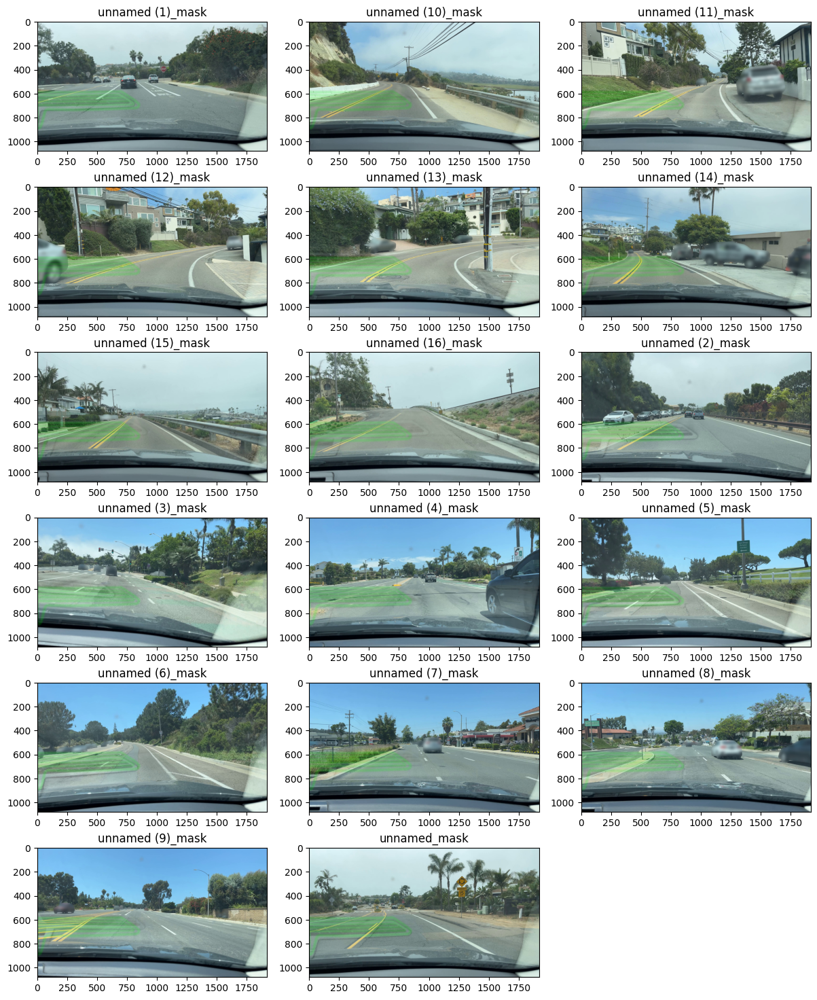

In [34]:
num_frames = 100
plot(
    {
        k: v
        for i, (k, v) in enumerate(frames.items())
        if k.endswith("mask") and i < num_frames * 2
    }, )


## Mix reflection mask with segmentations


Trying to compensate segmentations with known reflections


In [23]:
from __future__ import annotations
from ds_contrib.core.paths import list_paths

In [24]:
DATA_ROOT = Path("../data/encenitas_pipeline")
CONVNEXT_SEGMENTATION = DATA_ROOT / "uuid3200/segmentation"
POOLFORMER_SEGMENTATION = DATA_ROOT / "uuid3210/segmentation"
IMAGES_ROOT = DATA_ROOT / "images"

In [25]:
paths = list_paths(CONVNEXT_SEGMENTATION, recursive=True)

In [26]:
from typing import Callable


def map_files_path_based(base_file, mappings: dict[str, Callable],
                         base_file_key: str) -> dict[str, Path]:
    # map file paths based on corresponding base file path and mapping function
    # base_file: PathLike
    # mappings: Iterable[Callable[[Path], Path]]
    # returns: Iterable[Path]
    base_file = Path(base_file)
    result_dict = {base_file_key: base_file}
    for k, mapping_func in mappings.items():
        result_dict[k] = mapping_func(base_file)

    return result_dict

In [27]:
poolformer_mapping = lambda p: POOLFORMER_SEGMENTATION / p.name
convnext_mapping = lambda p: CONVNEXT_SEGMENTATION / p.name

In [28]:
from functools import partial

samples = list(
    map(
        partial(
            map_files_path_based,
            mappings={
                "poolformer": poolformer_mapping,
                "convnext": convnext_mapping
            },
            base_file_key="image",
        ),
        sorted(list_paths(IMAGES_ROOT), key=lambda p: int(p.stem)),
    ))


In [29]:
def open_sample(samples, id):
    sample = {k: PIL.Image.open(v) for k, v in samples[id].items()}
    return sample

In [30]:
from ds_contrib.core.plotting import Color, ImageLike, plot
from ds_contrib.core.plotting import bin_mask_overlay

colors = [
    Color.RED,
    Color.BLUE,
    Color.CYAN,
    Color.PINK,
    Color.YELLOW,
    Color.GREEN,
    Color.ORANGE,
    Color.PURPLE,
    Color.BROWN,
]


def overlay_all_masks(image, masks, transparency=0.5):
    canvas = image.copy()
    for mask, color in zip(masks, colors):
        canvas = bin_mask_overlay(canvas,
                                  mask,
                                  mask_color=color,
                                  transparency=transparency)
    return canvas


def overlay_sample(sample: dict[str, ImageLike], transparency=0.5):
    image = sample["image"]
    masks = [np.array(v) for k, v in sample.items() if k != "image"]
    return overlay_all_masks(image, masks, transparency=transparency)

In [31]:
contours_mask = draw_contours(mask, np.zeros((1080, 1920)))

In [32]:
soft_mask = generate_soft_mask_around_contours(contours_mask,
                                               15,
                                               0.05,
                                               max_val=0.5)


In [42]:
overlayed_sample = overlay_sample(open_sample(samples, 51), transparency=0.75)

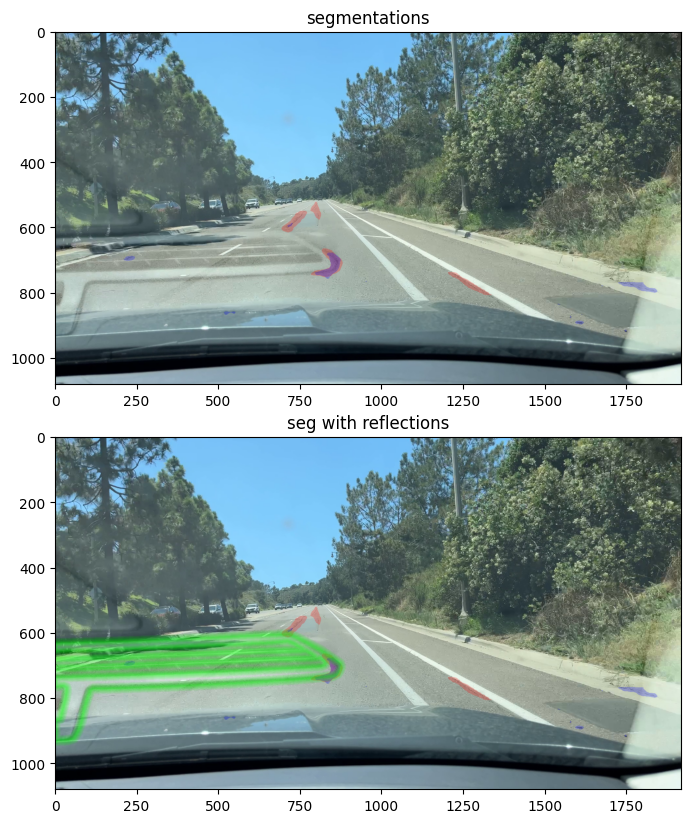

In [44]:
plot(
    {
        "segmentations": overlayed_sample,
        "seg with reflections": soft_mask_overlay(
            overlayed_sample, soft_mask, mask_color=Color.GREEN
        ),
    },
    max_col_width=1,
    max_row_height=0.5,
)